(topic:validation_legacy)=
# Napari-stress validation

This notebook focuses on the validation of the napari-stress implementation of the legacy code from Gross et al. ({cite}`gross2021stress`). It uses the original dataset that was used in the analysis and compares each result to the original results.

In [1]:
import napari
import numpy as np
from napari_stress import (reconstruction, measurements, utils, stress_backend,
                           plotting, frame_by_frame, TimelapseConverter)
import os
import vedo
import napari_process_points_and_surfaces as nppas

from skimage import io
import matplotlib.pyplot as plt
import seaborn as sns
from tifffile import imread

In [2]:
viewer = napari.Viewer(ndisplay=3)

Assistant skips harvesting pyclesperanto as it's not installed.


## Load the data

We load the original data as follows. The analysis only takes into account the first 21 timesteps, which equivalents to 60 minutes of data. The scale of the data is `[4, 0.346, 0.346]µm³` per voxel. The interfacial tension of the used droplet is `3.3 mN/m`.


In [3]:
root  = r'D:\Johannes\Nextcloud\Shared\Campaslab\projects\napari-stress-paper\data\3DTimelapse-vsx0_2023-08-11_13-11-51'
filename = os.path.join(root, '3DTimelapse-vsx0.346um-vsz4um-pinhole299um0-vst3min-16zSteps-30timeSteps-memNG-cy5Drop.lsm')
image = imread(filename)[:20]

# get number of frames
n_frames = image.shape[0]
image.shape

(20, 16, 3, 1024, 1024)

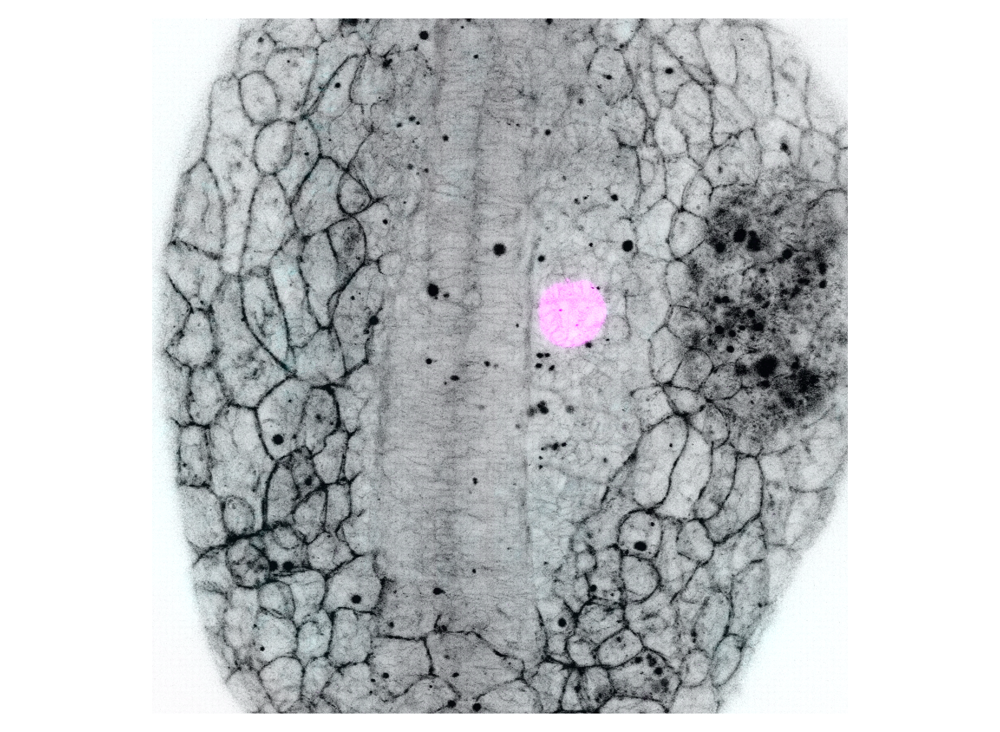

In [4]:
viewer.add_image(image[:, :, 0], name='membrane', colormap='gray_r', blending='translucent', scale=[1, 4, 0.346, 0.346])
viewer.add_image(image[:, :, 1], name='droplet', colormap='magenta', blending='additive', scale=[1, 4, 0.346, 0.346])
viewer.add_image(image[:, :, 2], name='other', colormap='cyan', blending='additive', scale=[1, 4, 0.346, 0.346])
napari.utils.nbscreenshot(viewer, canvas_only=True)

### Data dimensions
You need to set a few parameters pertaining to your data:

In [5]:
voxel_size_x = 0.346  # microns
voxel_size_y = 0.346  # microns
voxel_size_z = 3.998  # microns
target_voxel_size = 2  # microns
time_step = 3  # minutes

## Analysis

We first put all parameters into a dictionary so we can save and reload them later. The parameters are explained here:
- [Reconstruction](toolboxes:droplet_reconstruction:interactive)
- [Measurement](toolboxes:stress_toolbox:stress_toolbox_interactive)

In [6]:
reconstruction_parameters = {
    'voxelsize': np.asarray([voxel_size_z, voxel_size_y, voxel_size_x]),
    'target_voxelsize': 2,
    'smoothing_sigma': 1,
    'n_smoothing_iterations': 15,
    'n_points': 256,
    'n_tracing_iterations': 2,
    'resampling_length': 1,
    'fit_type': 'fancy',
    'edge_type': 'interior',
    'trace_length': 15,
    'sampling_distance': 0.5,
    'interpolation_method':  'linear',
    'outlier_tolerance': 1.5,
    'remove_outliers': True,
    'return_intermediate_results': True,
    'use_dask': True}

measurement_parameters = {
    'max_degree': 20,
    'n_quadrature_points': 5810,
    'gamma': 3.3,
    'use_dask': True}

We run the reconstruction and the stress analysis:

In [7]:
results_reconstruction = reconstruction.reconstruct_droplet(image[:, :, 1], **reconstruction_parameters)

Dask client up and running <Client: 'tcp://127.0.0.1:8872' processes=8 threads=40, memory=511.51 GiB>  Log: http://127.0.0.1:8871/status


In [8]:
_ = stress_backend.lbdv_info(Max_SPH_Deg=measurement_parameters['max_degree'],
                             Num_Quad_Pts=measurement_parameters['n_quadrature_points'])

results_stress_analysis = measurements.comprehensive_analysis(results_reconstruction[2][0], **measurement_parameters)

Dask client already running <Client: 'tcp://127.0.0.1:8872' processes=8 threads=40, memory=511.51 GiB>  Log: http://127.0.0.1:8871/status


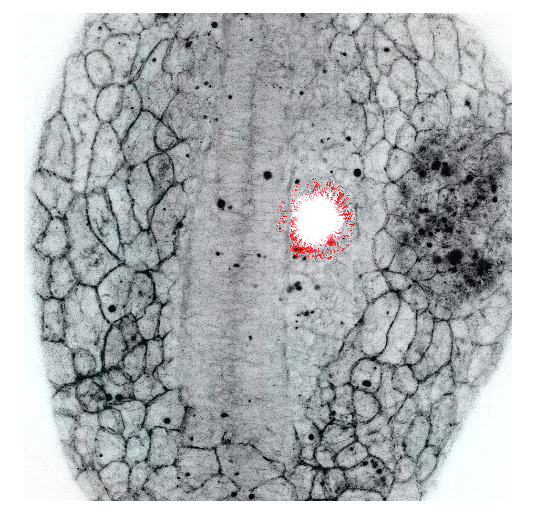

In [9]:
for res in results_reconstruction + results_stress_analysis:
    layer = napari.layers.Layer.create(res[0], res[1], res[2])
    viewer.add_layer(layer)
napari.utils.nbscreenshot(viewer, canvas_only=True)

## Create paper screenshots and figures

In [11]:
viewer.layers['membrane'].depiction = 'volume'
viewer.layers['droplet'].depiction = 'volume'
viewer.layers['other'].visible = False

We move the rendered plane to the center of mass of the droplet:

In [12]:
figure_directory = r'D:\Johannes\Nextcloud\Shared\Campaslab\projects\napari-stress-paper\documents\manuscript\figures\Figure7\imgs'

## Views on data

In [45]:
def set_timepoint(viewer, current_timepoint):
    # taken from https://github.com/haesleinhuepf/napari-time-slicer/blob/main/src/napari_time_slicer/_function.py
    variable_timepoint = list(viewer.dims.current_step)
    variable_timepoint[0] = current_timepoint
    viewer.dims.current_step = variable_timepoint

def make_layers_invisible(viewer):
    for layer in viewer.layers:
        layer.visible = False

In [46]:
timepoint = 10
set_timepoint(viewer, timepoint)

In [47]:
viewer.dims.current_step

(10, 8, 512, 512)

## Reconstruction workflow

### 3D overview figure

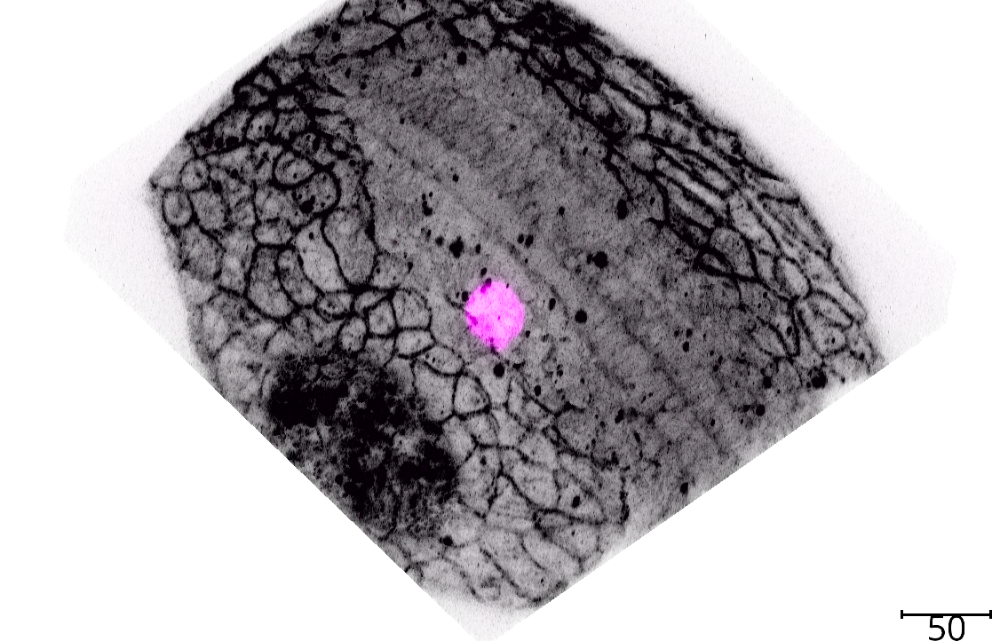

In [49]:
make_layers_invisible(viewer)

viewer.window.resize(1400, 800)
viewer.layers['membrane'].visible = True
viewer.layers['droplet'].visible = True
viewer.camera.center = (36.0, 148.0, 210.0)
viewer.camera.zoom = 2
viewer.camera.angles = (-145, 26, 66)

viewer.scale_bar.visible = True

screenshot = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "droplet_membranes_3D.png"), screenshot)

napari.utils.nbscreenshot(viewer, canvas_only=True)

### 2D closeup

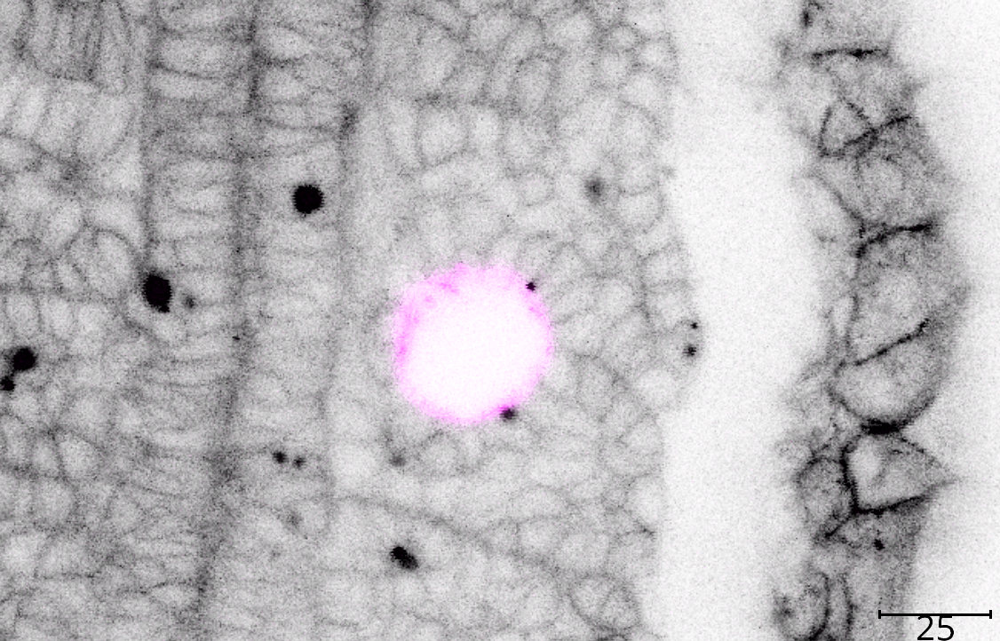

In [50]:
CoM_droplet = viewer.layers['Center'].data[:, 1:][0]

viewer.window.resize(1400, 800)
viewer.layers['droplet'].depiction = "plane"
viewer.layers['membrane'].depiction = 'plane'
viewer.layers['membrane'].plane.position = CoM_droplet/ viewer.layers['membrane'].scale[1:]
viewer.layers['droplet'].plane.position = CoM_droplet/ viewer.layers['droplet'].scale[1:]

viewer.camera.center = (0, 145, 220)
viewer.camera.zoom = 5
viewer.camera.angles = (0, 0, 90)

screenshot = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "droplet_membranes_2D_planes.png"), screenshot)

napari.utils.nbscreenshot(viewer, canvas_only=True)

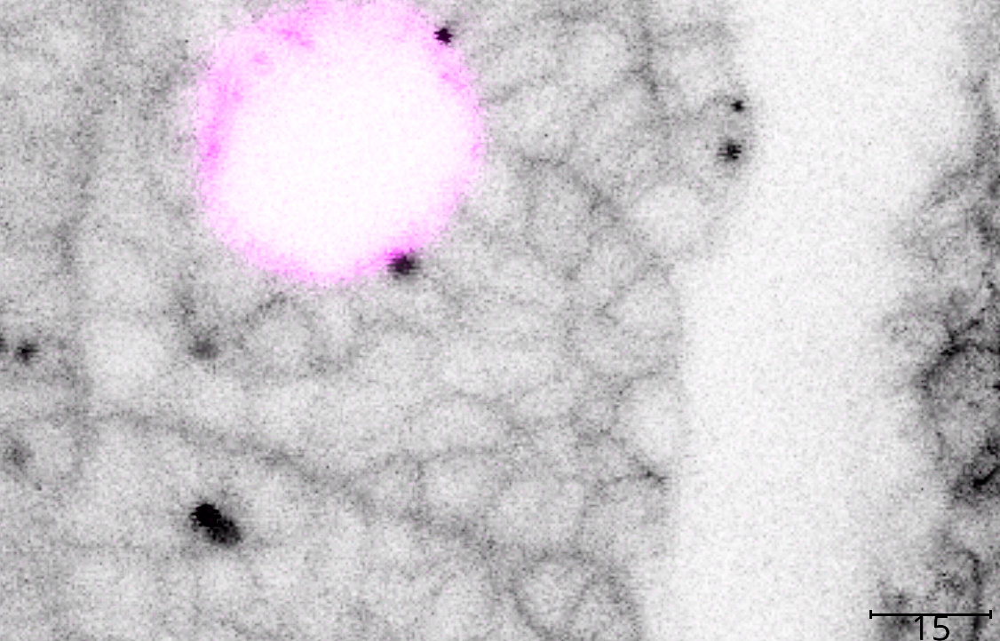

In [51]:
viewer.dims.ndisplay = 3
viewer.window.resize(1400, 800)
viewer.camera.center = (0, 173, 234)
viewer.camera.zoom = 9
viewer.camera.angles = (0, 0, 90)


viewer.layers['membrane'].blending = 'translucent'
viewer.layers['membrane'].depicion = 'plane'

screenshot = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "droplet_membranes_2D_2D.png"), screenshot)

napari.utils.nbscreenshot(viewer, canvas_only=True)

### Label image

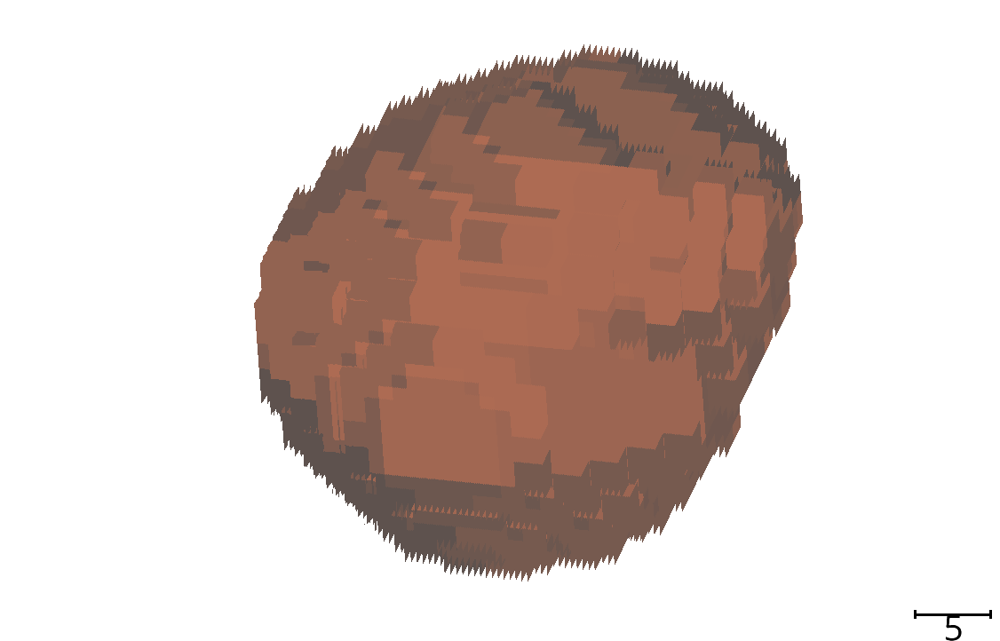

In [52]:
make_layers_invisible(viewer)
viewer.layers['Label image'].visible = True

viewer.window.resize(1400, 800)
viewer.camera.center = (22, 162, 195)
viewer.camera.zoom = 17
viewer.camera.angles = (-116, 53, -25)

screenshot = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "droplet_label.png"), screenshot)

napari.utils.nbscreenshot(viewer, canvas_only=True)

### First guess

In [21]:
make_layers_invisible(viewer)
surface = frame_by_frame(nppas.largest_label_to_surface)(viewer.layers['Label image'].data)
surface_smooth = frame_by_frame(nppas.smooth_surface)(surface, 15)
surface_decimated = frame_by_frame(nppas.decimate_quadric)(surface_smooth, number_of_vertices=256)
viewer.add_points(surface_decimated[0], size=0.2, name='droplet surface points', scale=[1, 2, 2, 2])
viewer.add_surface(surface_decimated, name='droplet surface', scale=[1, 2, 2, 2])

         mesh.points() -> mesh.vertices
         (silence this with vedo.core.warnings['points_getter']=False)


<Surface layer 'droplet surface' at 0x1b48ff15b80>

In [53]:
from napari_threedee.utils.napari_utils import get_dims_displayed
layer = viewer.layers['droplet surface']
view_direction = np.asarray(viewer.camera.view_direction)
dims_displayed = get_dims_displayed(layer)
layer_view_direction = np.asarray(layer._world_to_data_ray(view_direction))[dims_displayed]

visual = viewer.window._qt_window._qt_viewer.layer_to_visual[layer]
visual.node.shading_filter.light_dir = layer_view_direction[::-1]
layer.refresh()

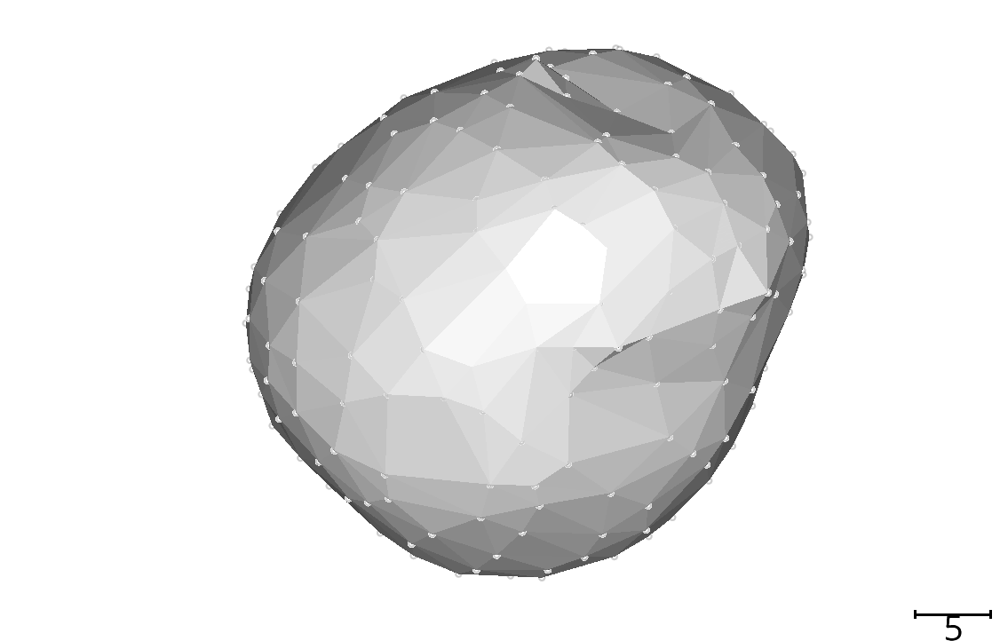

In [54]:
make_layers_invisible(viewer)
viewer.window.resize(1400, 800)
viewer.layers['droplet surface'].visible = True
viewer.layers['droplet surface points'].visible = True
screenshot = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "droplet_first_guess.png"), screenshot)

napari.utils.nbscreenshot(viewer, canvas_only=True)

### Trace vectors

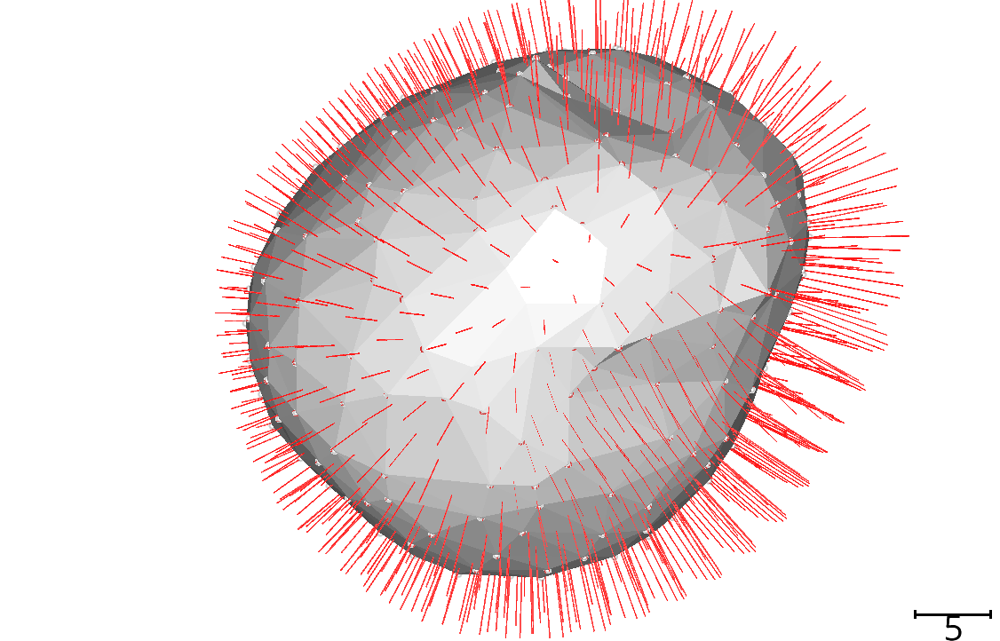

In [55]:
viewer.window.resize(1400, 800)
viewer.layers['Normals'].visible = True
viewer.layers['Normals'].edge_width = 0.1
viewer.layers['Normals'].length = 0.7

screenshot = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "droplet_normals.png"), screenshot)

napari.utils.nbscreenshot(viewer, canvas_only=True)

### Reconstruction

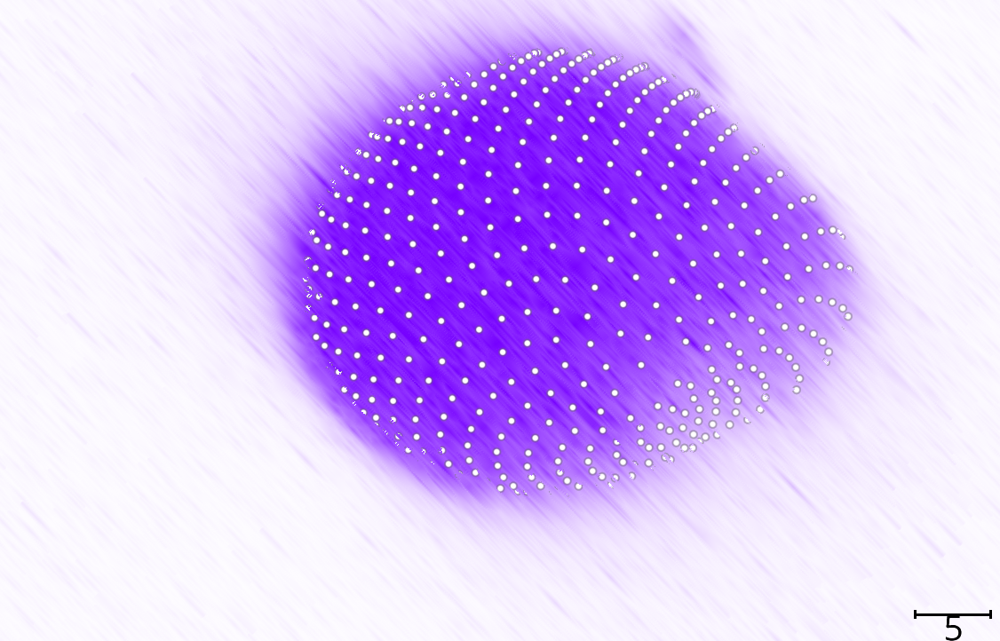

In [56]:
make_layers_invisible(viewer)
viewer.window.resize(1400, 800)
viewer.layers['droplet'].visible = True
viewer.layers['droplet'].depiction = 'volume'
viewer.layers['points_patch_fitted'].visible = True
viewer.layers['droplet'].blending = 'translucent'
viewer.layers['droplet'].colormap = 'I Purple'

viewer.camera.center = (35, 155, 207)
viewer.camera.angles = (-50, 51, 87)

screenshot = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "droplet_refined.png"), screenshot)

napari.utils.nbscreenshot(viewer, canvas_only=True)

#### Total stress

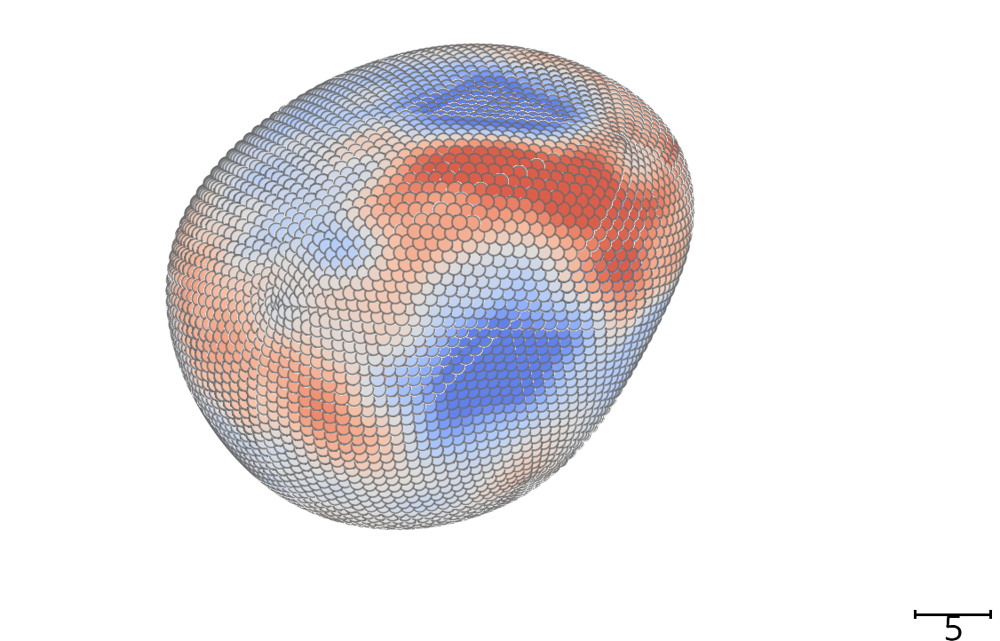

In [57]:
viewer.camera.angles = (-116, 53, -25)

make_layers_invisible(viewer)
viewer.window.resize(1400, 800)
viewer.layers['droplet'].blending = 'translucent'
viewer.layers['membrane'].visible = False
viewer.layers['Result of lebedev quadrature (droplet)'].visible = True
viewer.layers['Result of lebedev quadrature on ellipsoid'].visible = False

viewer.layers['Result of lebedev quadrature (droplet)'].face_color = 'stress_total'
viewer.layers['Result of lebedev quadrature (droplet)'].face_colormap = 'coolwarm'
viewer.layers['Result of lebedev quadrature (droplet)'].face_contrast_limits = [-0.35, 0.35]
viewer.layers['Result of lebedev quadrature (droplet)'].refresh()
viewer.layers['Result of lebedev quadrature (droplet)'].size = 1

screenshot_total_stress = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "stress_total.png"), screenshot_total_stress)

napari.utils.nbscreenshot(viewer, canvas_only=True)

#### Cell stress

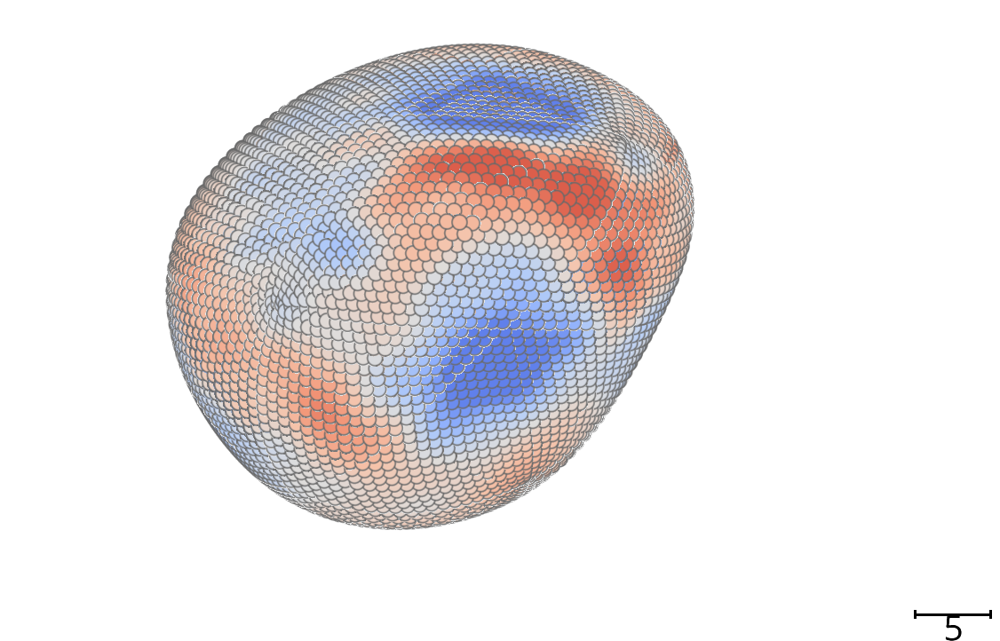

In [58]:
viewer.layers['Result of lebedev quadrature (droplet)'].face_color = 'stress_cell'
viewer.layers['Result of lebedev quadrature (droplet)'].face_colormap = 'coolwarm'
viewer.layers['Result of lebedev quadrature (droplet)'].face_contrast_limits = [-0.35, 0.35]
viewer.layers['Result of lebedev quadrature (droplet)'].refresh()
viewer.layers['Result of lebedev quadrature (droplet)'].size = 1
viewer.window.resize(1400, 800)

screenshot_cell_stress = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "stress_cell.png"), screenshot_cell_stress)

napari.utils.nbscreenshot(viewer, canvas_only=True)

#### Tissue stress

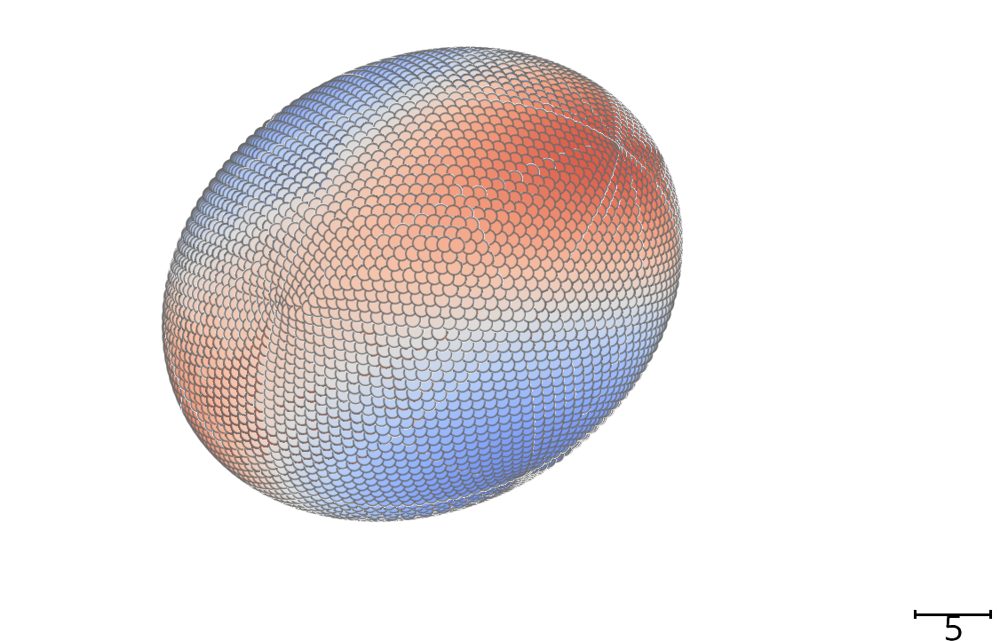

In [59]:
viewer.layers['Result of lebedev quadrature (droplet)'].visible = False
viewer.layers['Result of lebedev quadrature on ellipsoid'].visible = True
viewer.layers['Result of lebedev quadrature on ellipsoid'].face_color = 'stress_tissue'
viewer.layers['Result of lebedev quadrature on ellipsoid'].face_colormap = 'coolwarm'
viewer.layers['Result of lebedev quadrature on ellipsoid'].face_contrast_limits = [-0.1, 0.1]
viewer.layers['Result of lebedev quadrature on ellipsoid'].refresh()
viewer.layers['Result of lebedev quadrature on ellipsoid'].size = 1
viewer.window.resize(1400, 800)

screenshot_tissue_stress = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "stress_tissue.png"), screenshot_tissue_stress)

napari.utils.nbscreenshot(viewer, canvas_only=True)

### Extremal stress 3D

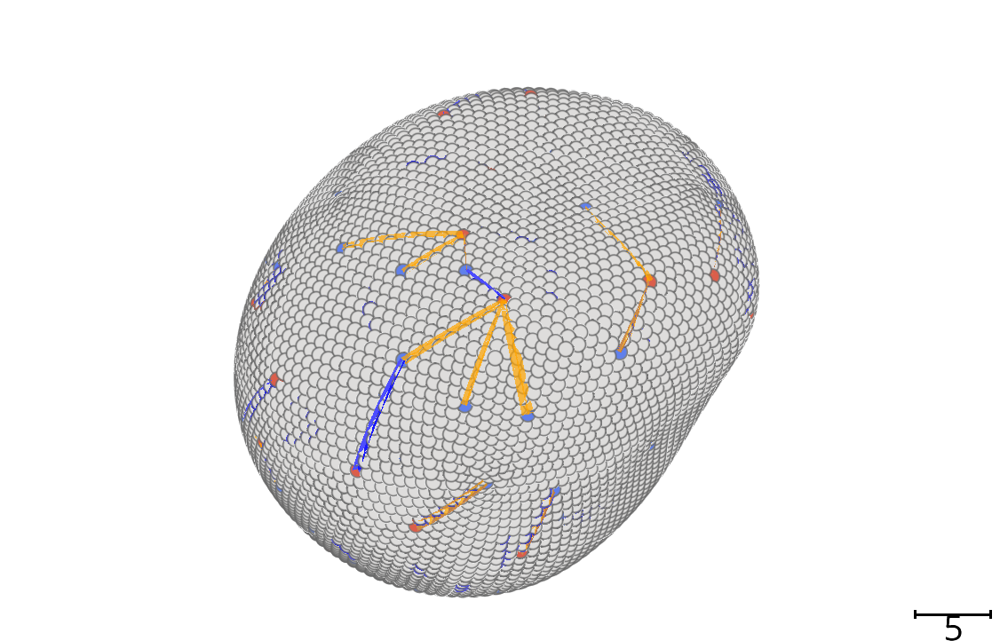

In [62]:
viewer.window.resize(1400, 800)
viewer.camera.center = (35, 155, 207)
viewer.camera.angles = (-70, 30, 16)
viewer.layers['Result of lebedev quadrature (droplet)'].visible = True
viewer.layers['Result of lebedev quadrature on ellipsoid'].visible = False
viewer.layers['Result of lebedev quadrature (droplet)'].size = 1

viewer.layers['Total stress: Geodesics maxima -> nearest minima'].visible = True
viewer.layers['Total stress: Geodesics maxima -> nearest minima'].edge_width = 0.8
viewer.layers['Total stress: Geodesics minima -> nearest maxima'].visible = True
viewer.layers['Total stress: Geodesics minima -> nearest maxima'].edge_width = 0.8
viewer.layers['Result of lebedev quadrature (droplet)'].face_color = 'stress_total_extrema'
viewer.layers['Result of lebedev quadrature (droplet)'].face_colormap = 'coolwarm'
viewer.layers['Result of lebedev quadrature (droplet)'].face_contrast_limits = [-1, 1]
viewer.layers['Result of lebedev quadrature (droplet)'].refresh()

screenshot_nearest_extrema_3d = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "droplet_nearest_extrema_3d.png"), screenshot_nearest_extrema_3d)

napari.utils.nbscreenshot(viewer, canvas_only=True)

## Advanced visualizations

In this section, we create some advanced visualizations to highlight the interplay between the obtained measurements and their biological relevance.

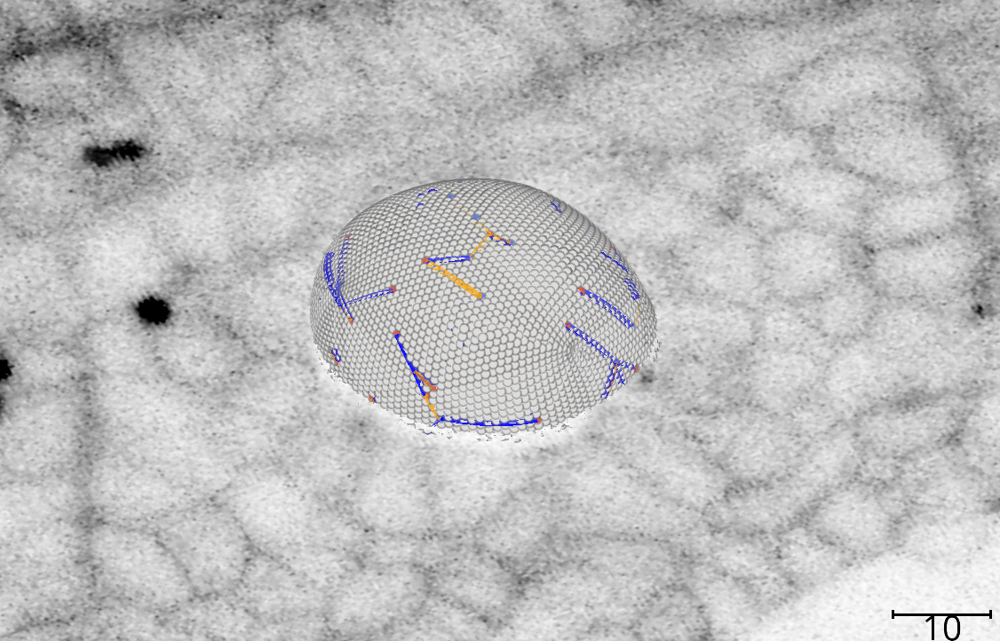

In [67]:
set_timepoint(viewer, 4)
viewer.camera.center = (35,147,209)
viewer.camera.angles = (-57, 40, 112)
viewer.camera.zoom = 11

viewer.layers['membrane'].visible = True
viewer.layers['membrane'].plane.position = (7.5, 443, 697)
viewer.layers['Result of lebedev quadrature (droplet)'].visible = True
viewer.layers['Result of lebedev quadrature on ellipsoid'].visible = False
viewer.layers['Result of lebedev quadrature (droplet)'].size = 1

viewer.layers['Total stress: Geodesics maxima -> nearest minima'].visible = True
viewer.layers['Total stress: Geodesics maxima -> nearest minima'].edge_width = 0.8
viewer.layers['Total stress: Geodesics minima -> nearest maxima'].visible = True
viewer.layers['Total stress: Geodesics minima -> nearest maxima'].edge_width = 0.8
viewer.layers['Result of lebedev quadrature (droplet)'].face_color = 'stress_total_extrema'
viewer.layers['Result of lebedev quadrature (droplet)'].face_colormap = 'coolwarm'
viewer.layers['Result of lebedev quadrature (droplet)'].face_contrast_limits = [-1, 1]
viewer.layers['Result of lebedev quadrature (droplet)'].refresh()

screenshot_nearest_extrema_3d = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "droplet_membrane_nearest_extrema_3d.png"), screenshot_nearest_extrema_3d)

napari.utils.nbscreenshot(viewer, canvas_only=True)

### Timelapse orientation overview

In [73]:
overview_projected = viewer.layers['Result of least squares ellipsoid'].data[2::3]
viewer.layers['membrane'].blending = 'translucent'
viewer.layers['droplet'].blending = 'additive'

overview_projected[:, 0, 0] = 10
overview_projected[:, 1, 0] = 10

set_timepoint(viewer, 10)
viewer.add_vectors(overview_projected, name='orientation',
                   features={'time': np.arange(overview_projected.shape[0])},
                   edge_color='time', edge_colormap='coolwarm')

viewer.camera.angles = (-47, 2, 82)
viewer.camera.zoom = 6.2

screenshot_orientation = viewer.screenshot()
io.imsave(os.path.join(figure_directory, "droplet_orientation.png"), screenshot_orientation)

### Make intersection of droplet and viewing plane

In [ ]:
Converter = TimelapseConverter()
surfaces = Converter.data_to_list_of_data(viewer.layers['stress_autocorrelations'].data,
                                          layertype='napari.types.SurfaceData')

meshes = [vedo.Mesh((surf[0], surf[1])) for surf in surfaces]
intersection = [mesh.intersect_with_plane(origin = CoM_droplet) for mesh in meshes]
points = [inters.points() for inters in intersection]

# order points (z, y, x) clockwise with respect to (1, 0, 0) axis
points_centered = [pt - CoM_droplet for pt in points]
angles = [np.arctan2(pt[:, 1], pt[:, 2]) for pt in points_centered]
points_ordered = [pt[np.argsort(ang)] for pt, ang in zip(points, angles)]

# add a column at index zero for time for each array in points_ordered, which
points_ordered = [np.insert(pt, 0, np.ones(len(pt)) * i, axis=1) for i, pt in enumerate(points_ordered)]

# viewer.add_shapes(data=points_ordered, shape_type='polygon', edge_color='black',
#                   edge_width=0.1, name='path' )

         mesh.points() -> mesh.vertices
         (silence this with vedo.core.warnings['points_getter']=False)


<Shapes layer 'path' at 0x1e285733ac0>

## Plots

In this section, we produce the plots for the figure in the paper that compare key results between the two implementations, namely: The total/cellular/tissue stresses, the spatial autocorrelations 

In [74]:
# Compile data
df_over_time, df_nearest_pairs, df_all_pairs, df_autocorrelations = utils.compile_data_from_layers(
    results_stress_analysis, n_frames=n_frames, time_step=time_step)

In [75]:
%%capture
figures_dict = plotting.create_all_stress_plots(
    results_stress_analysis,
    time_step=time_step,
    n_frames=n_frames
)

## Quantitative plots

In this section we create some quantitiative plots which demonstrate the match between the two implementations. Most noteably, we compare the total, cellular and tissue stress anisotropies as well as the spatial autocorrelation of the total stress.

In [76]:
max_time = (image[:, :, 1].shape[0] - 1) * time_step

In [77]:
drop = viewer.layers['Result of lebedev quadrature on ellipsoid'].data
center = [drop[drop[:,0] == t].mean(axis=0) for t in np.arange(n_frames)]
radius = np.mean([np.sqrt(((drop[drop[:,0] == t] - center[t])**2).sum(axis=1)).mean() for t in np.arange(n_frames)])

## Total stress

This is the total stress anisotropy measured using the Matlab-based reconstruction:

![](./imgs/total_stress_anisotropy.jpg)

...and this is the result of the napari-stress based implementation (note the different axis limits). As you can see, the results are very similar down to the second decimal place (~10kPa).

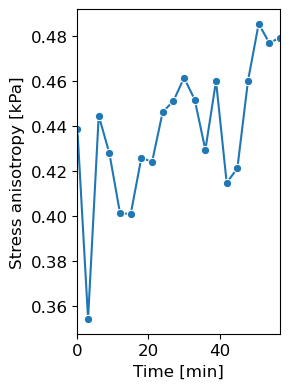

In [82]:
fig, ax = plt.subplots(figsize=(3, 4))
sns.lineplot(data=df_over_time, x='time', y='stress_total_anisotropy', ax=ax,
             markers=True, dashes=False, marker='o')

ax.set_xlim([0,  max_time])
ax.set_xlabel("Time [min]", fontsize=12)
ax.set_ylabel("Stress anisotropy [kPa]", fontsize=12)

# set fontsize of ticks
ax.tick_params(axis='both', which='major', labelsize=12)

fig.tight_layout()
fig.savefig(
    os.path.join(figure_directory, 'droplet_stress_total_anisotropy_over_time.png'),
    dpi=300,
    bbox_inches='tight')

## Tissue stress

For tissue stress, the Matlab-based implementation yields the following result:

![](./imgs/tissue_stress_anisotropy.jpg)

...and the napari-stress based implementation yields the following result:

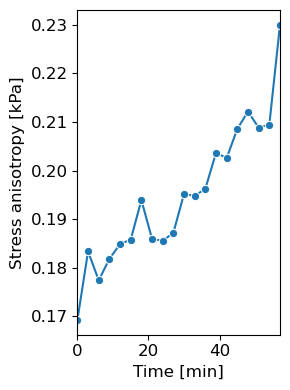

In [83]:
fig, ax = plt.subplots(figsize=(3, 4))
sns.lineplot(data=df_over_time, x='time', y='stress_tissue_anisotropy', ax=ax,
             markers=True, dashes=False, marker='o')

ax.set_xlim([0,  max_time])
ax.set_xlabel("Time [min]", fontsize=12)
ax.set_ylabel("Stress anisotropy [kPa]", fontsize=12)

# set fontsize of ticks
ax.tick_params(axis='both', which='major', labelsize=12)

fig.tight_layout()
fig.savefig(
    os.path.join(figure_directory, 'droplet_stress_tissue_anisotropy_over_time.png'),
    dpi=300,
    bbox_inches='tight')

## Cell stress

Lastly, the cell stress anisotropy is measured as follows using the Matlab-based implementation:

![](./imgs/cell_stress_anisotropy.jpg)

...and the napari-stress based implementation yields the following result:


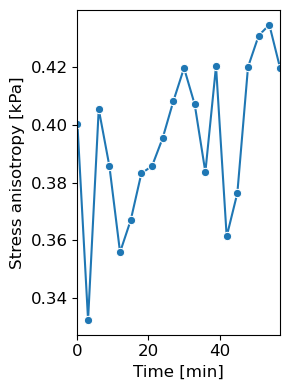

In [84]:
fig, ax = plt.subplots(figsize=(3, 4))
sns.lineplot(data=df_over_time, x='time', y='stress_cell_anisotropy', ax=ax,
             markers=True, dashes=False, marker='o')

ax.set_xlim([0,  max_time])
ax.set_xlabel("Time [min]", fontsize=12)
ax.set_ylabel("Stress anisotropy [kPa]", fontsize=12)

# set fontsize of ticks
ax.tick_params(axis='both', which='major', labelsize=12)

fig.tight_layout()
fig.savefig(
    os.path.join(figure_directory, 'droplet_stress_cell_anisotropy_over_time.png'),
    dpi=300,
    bbox_inches='tight')

## Spatial autocorrelations

The spatial autocorrelations for total and cellular stresses are reported as follows using the Matlab-based implementation:

![](./imgs/spatial_autocorrelation.jpg)

...and the napari-stress based implementation yields the following result for the total stress:

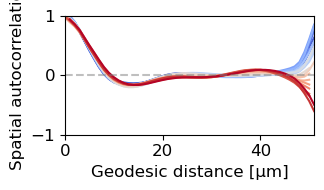

In [85]:
fig, ax = plt.subplots(figsize=(3.5, 2))

sns.lineplot(data=df_autocorrelations, x='distances', y='autocorrelations_spatial_total',
             hue='time', ax=ax, palette='coolwarm', legend=False)

ax.set_xlabel("Geodesic distance [µm]", fontsize=12)
ax.set_ylabel("Spatial autocorrelation", fontsize=12)

ax.set_xlim([0,  df_autocorrelations['distances'].max()])
ax.set_ylim([-1, 1])
ax.hlines(0, 0, df_autocorrelations['distances'].max(), linestyle='--', color='gray',
          alpha=0.5)

ax.tick_params(axis='both', which='major', labelsize=12)

fig.tight_layout()
fig.savefig(
    os.path.join(figure_directory, 'droplet_spatial_autocorrelation_total.png'),
    dpi=300,
)

and the following result for the cellular stress:

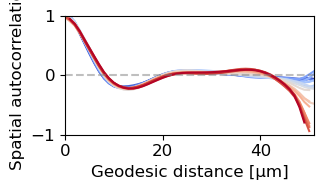

In [86]:
fig, ax = plt.subplots(figsize=(3.5, 2))

sns.lineplot(data=df_autocorrelations, x='distances', y='autocorrelations_spatial_cell',
             hue='time', ax=ax, palette='coolwarm', legend=False)

ax.set_xlabel("Geodesic distance [µm]", fontsize=12)
ax.set_ylabel("Spatial autocorrelation", fontsize=12)

ax.set_xlim([0,  df_autocorrelations['distances'].max()])
ax.set_ylim([-1, 1])
ax.hlines(0, 0, df_autocorrelations['distances'].max(), linestyle='--', color='gray',
          alpha=0.5)

ax.tick_params(axis='both', which='major', labelsize=12)

fig.tight_layout()
fig.savefig(
    os.path.join(figure_directory, 'droplet_spatial_autocorrelation_cell.png'),
    dpi=300,
)

## Geodesic distances

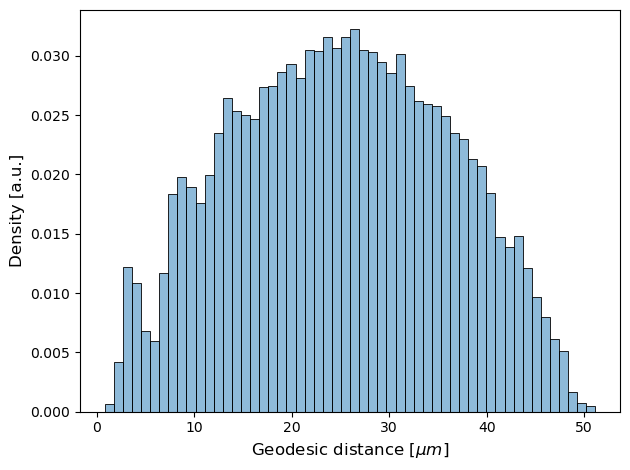

In [87]:
fig, ax = plt.subplots()
sns.histplot(data=df_all_pairs, x='stress_cell_all_pair_distance', ax=ax, stat='density',
             alpha=0.5)
ax.set_xlabel("Geodesic distance [$\mu m$]", fontsize=12)
ax.set_ylabel("Density [a.u.]", fontsize=12)

fig.tight_layout()
fig.savefig(os.path.join(figure_directory, 'spatial_autocorrelation_all_pair_distance'), dpi=300)

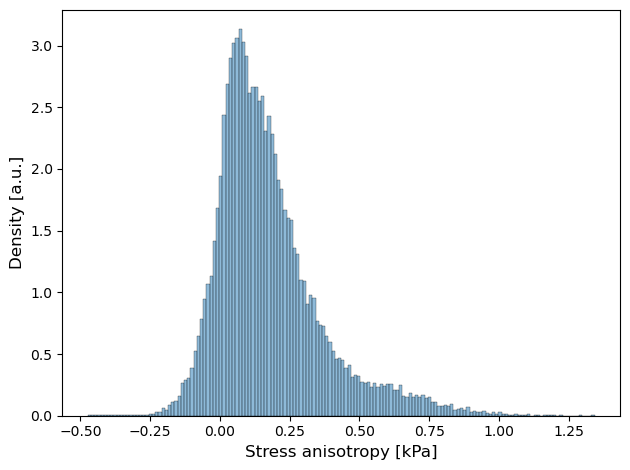

In [88]:
fig, ax = plt.subplots()
sns.histplot(data=df_all_pairs, x='stress_cell_all_pair_anisotropy', ax=ax, stat='density',
             alpha=0.5)
ax.set_xlabel("Stress anisotropy [kPa]", fontsize=12)
ax.set_ylabel("Density [a.u.]", fontsize=12)

fig.tight_layout()
fig.savefig(os.path.join(figure_directory, 'spatial_autocorrelation_all_pair_anisotropy'), dpi=300)

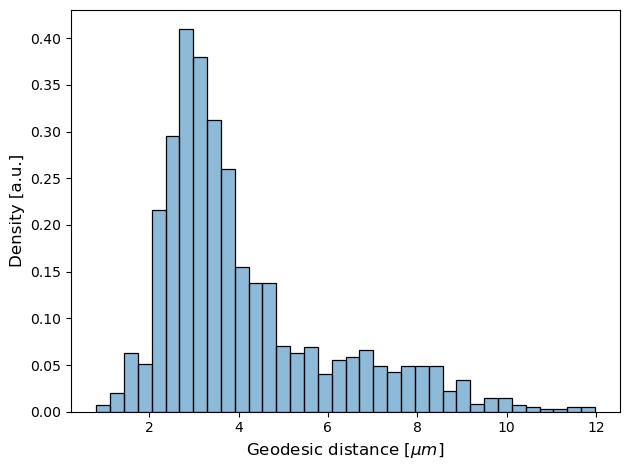

In [89]:
fig, ax = plt.subplots()
sns.histplot(data=df_nearest_pairs, x='stress_cell_nearest_pair_distance', ax=ax, stat='density',
             alpha=0.5)
ax.set_xlabel("Geodesic distance [$\mu m$]", fontsize=12)
ax.set_ylabel("Density [a.u.]", fontsize=12)

fig.tight_layout()
fig.savefig(os.path.join(figure_directory, 'spatial_autocorrelation_nearest_pair_distance'), dpi=300)

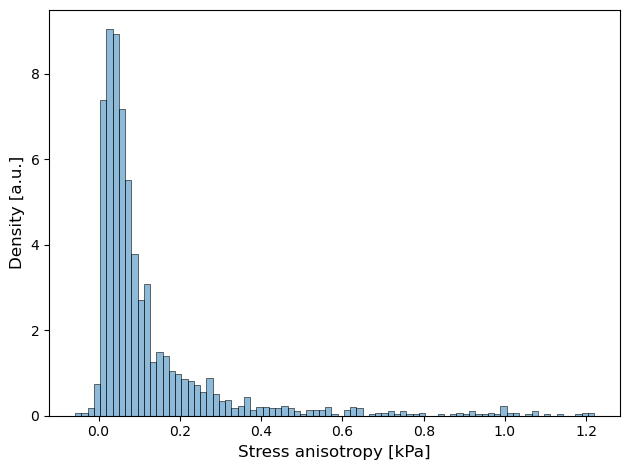

In [90]:
fig, ax = plt.subplots()
sns.histplot(data=df_nearest_pairs, x='stress_cell_nearest_pair_anisotropy', ax=ax, stat='density',
             alpha=0.5)
ax.set_xlabel("Stress anisotropy [kPa]", fontsize=12)
ax.set_ylabel("Density [a.u.]", fontsize=12)

fig.tight_layout()
fig.savefig(os.path.join(figure_directory, 'spatial_autocorrelation_nearest_pair_anisotropy'), dpi=300)